<a href="https://colab.research.google.com/github/dilia-w/Visao-Computacional/blob/main/atividade_11_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##02 - Rastreamento por Diferença entre Quadros

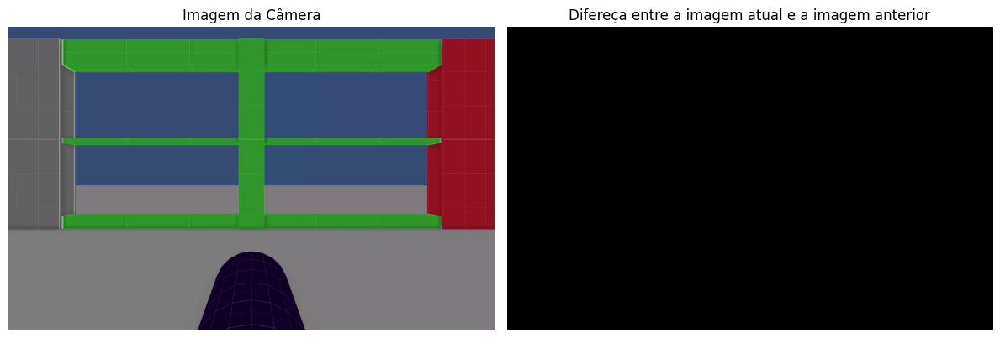

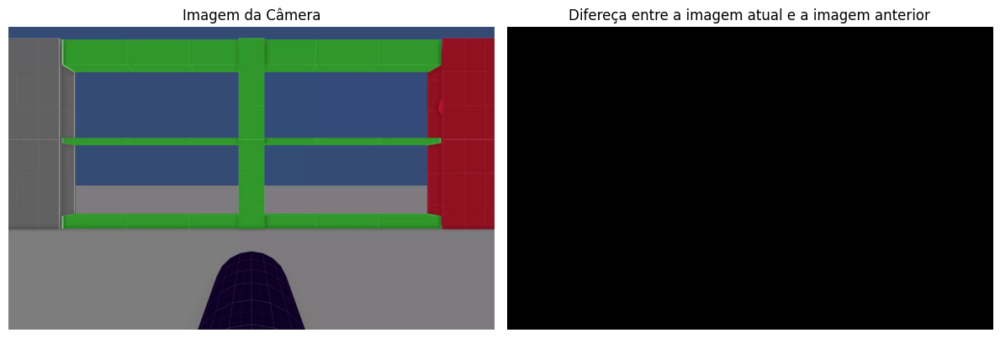

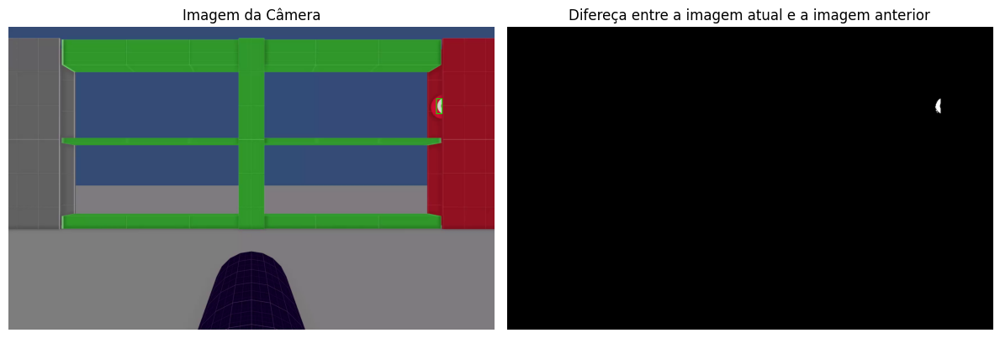

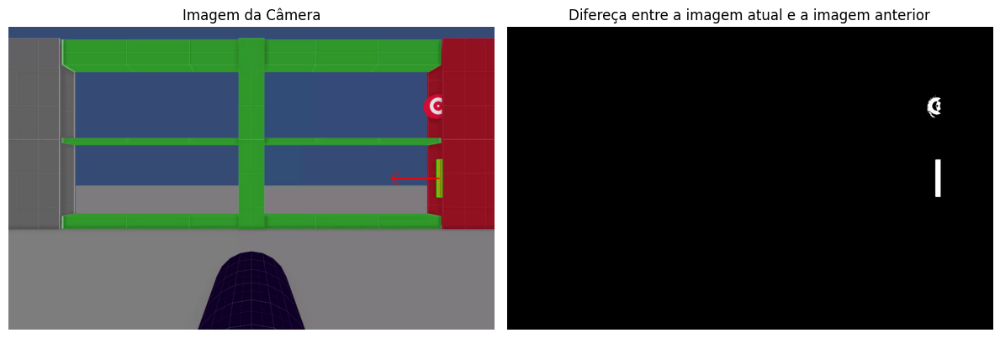

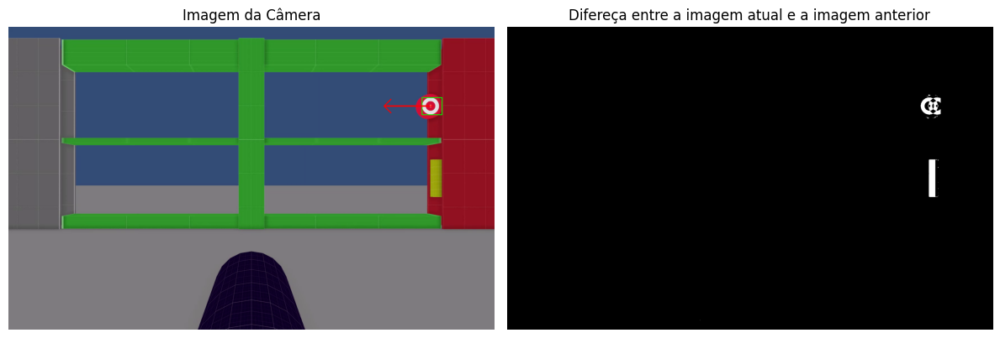

...

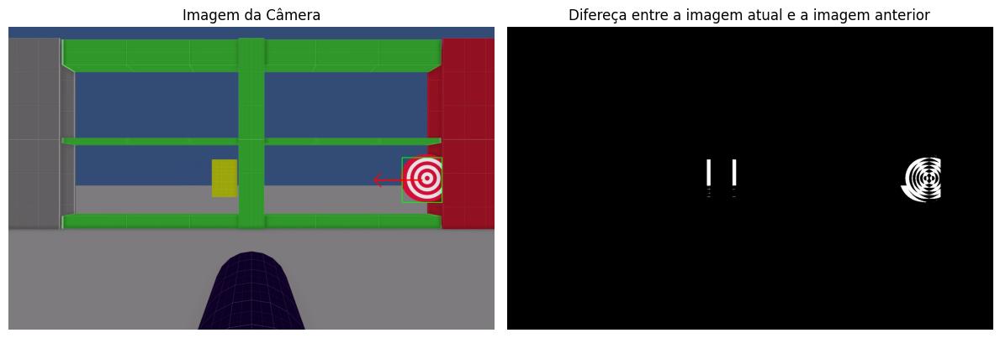

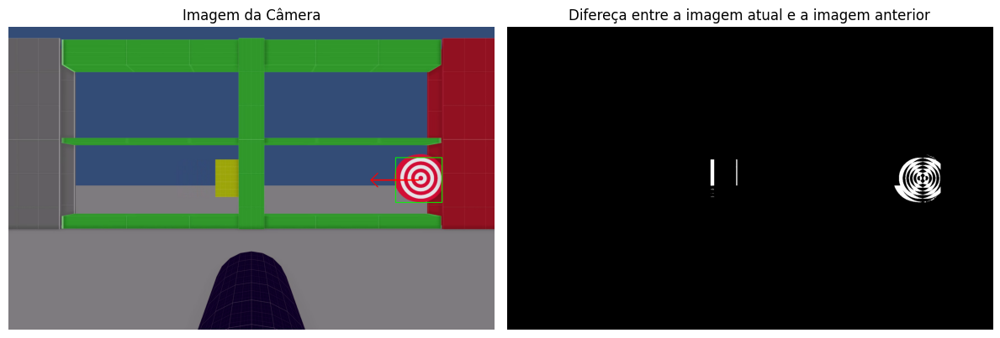

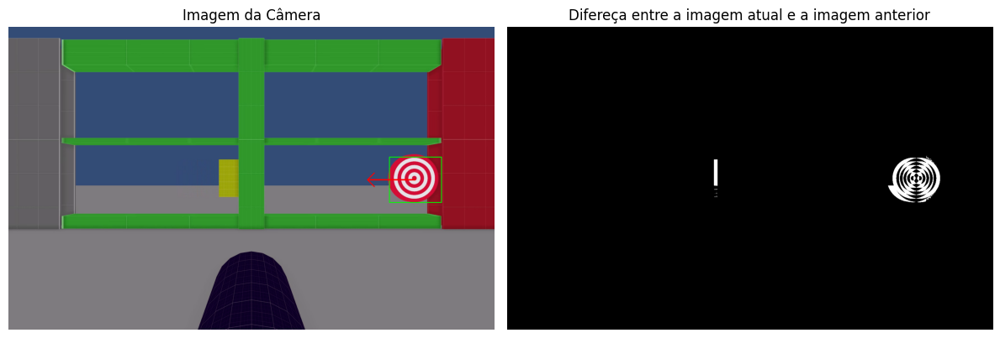

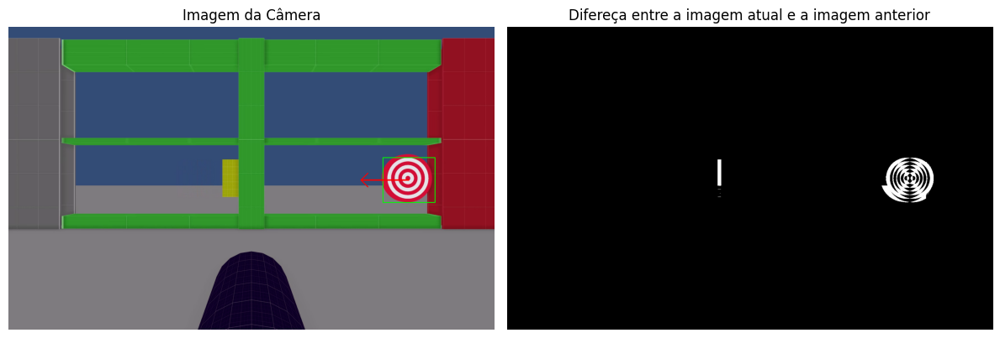

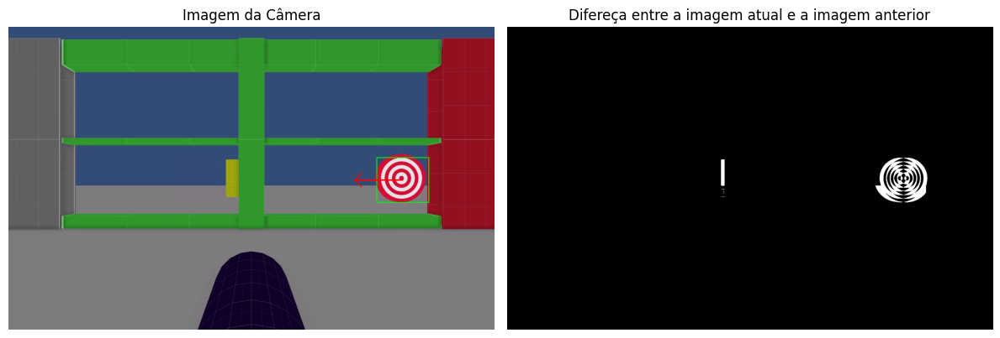

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Configuração para as marcações
box_color = (0, 255, 0)
box_thickness = 2
arrow_color = (0, 0, 255)
arrow_thickness = 4
arrow_size = 170
tipLength = 0.2
x_center_ant = None

cap = cv2.VideoCapture('movie_001.mp4')
ret, prev_frame = cap.read()
prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
step_frames = 3

while True:
    current_position = cap.get(cv2.CAP_PROP_POS_FRAMES)
    cap.set(cv2.CAP_PROP_POS_FRAMES, current_position + step_frames)
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    diff = cv2.absdiff(prev_gray, gray)
    _, thresholded = cv2.threshold(diff, 25, 255, cv2.THRESH_BINARY)

    # Encontre contornos no frame limiarizado
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Rastreamento do objeto de maior contorno
    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        if cv2.contourArea(largest_contour) > 500:
            x, y, w, h = cv2.boundingRect(largest_contour)
            cv2.rectangle(frame, (x, y), (x+w, y+h), box_color, box_thickness)
            x_center = int((2*x+w)/2)
            y_center = int((2*y+h)/2)
            if x_center_ant is not None:
                direcao = x_center - x_center_ant
                if (direcao > 0):
                    cv2.arrowedLine(frame, (x_center, y_center),
                       (x_center+arrow_size, y_center), arrow_color, arrow_thickness,
                       tipLength=tipLength)
                else:
                    cv2.arrowedLine(frame, (x_center, y_center),
                       (x_center-arrow_size, y_center), arrow_color, arrow_thickness,
                       tipLength=tipLength)
            x_center_ant = x_center

    # Apresenta o movimento
    plt.figure(figsize=(12, 10))
    plt.subplot(1,2,1)
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.title('Imagem da Câmera')
    plt.axis('off')
    plt.subplot(1,2,2)
    plt.imshow(thresholded, cmap='gray')
    plt.title('Difereça entre a imagem atual e a imagem anterior')
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    prev_gray = gray

cap.release()
